### Laboratorium 6 - część 1/2

W pakiecie OpenCV wszystkie zadania związane z detekcją i opisem punktów kluczowych realizowane są przez zestaw specjalnych klas, dla których bazową jest `cv::Feature2D`. Jedną z wielu pochodnych tej klasy jest interesująca nas na zajęciach `cv::SIFT`, z której dokumentacją należy się zapoznać.  
Najważniejsze, co trzeba wiedzieć:
1. do konstrukcji obiektu SIFT służy metoda [`cv2.SIFT_create`](https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#ad337517bfdc068ae0ba0924ff1661131) - to do niej przekazujemy parametry detektora (w dokumentacji występuje jako `cv::SIFT::create`);
2. obsługujemy detektor przez interfejs `cv::Feature2D`, konkretnie metody [`detect`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#aa4e9a7082ec61ebc108806704fbd7887) do detekcji punktów kluczowych oraz [`compute`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#ab3cce8d56f4fc5e1d530b5931e1e8dc0) do obliczania ich deskryptorów (opcjonalnie `detectAndCompute`).

Schemat użycia:
```python
sift_instance = cv2.SIFT_create()
# 'image' powinno być obrazem jednokanałowym (jeśli nie, zostanie zastosowane cvtColor z flagą COLOR_BGR2GRAY)
keypoints = sift_instance.detect(image)
keypoints, descriptors = sift_instance.compute(image, keypoints)
```

`keypoints` jest listą obiektów specjalnego typu `cv2.KeyPoint`, która **jest modyfikowana** przez `SIFT::compute`!  
`descriptors` jest natomiast macierzą float32 o wymiarach NxK, gdzie N jest liczbą punktów kluczowych, a K jest liczbą obliczonych cech.

Warto również zapoznać się z funkcją [`cv2.drawKeypoints`](https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920) w kontekście prezentacji wyników. Zwróć uwagę na flagi sterujące rysowaniem - szczególnie użyteczna jest `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib.axes import Axes
from qwlist import Lazy, QList
import seaborn as sns
from typing import Iterable, Callable, Optional, TypeVar, Sequence

In [2]:
LENA = cv2.cvtColor(cv2.imread('Lena.jpg'), cv2.COLOR_BGR2RGB)
LENA_GRAY = cv2.cvtColor(cv2.imread('Lena.jpg'), cv2.COLOR_BGR2GRAY)

CELLS = cv2.cvtColor(cv2.imread('p17_0216_7.jpg'), cv2.COLOR_BGR2RGB)
CELLS_GRAY = cv2.cvtColor(cv2.imread('p17_0216_7.jpg'), cv2.COLOR_BGR2GRAY)

#### Zadanie 1

Przetestuj wpływ podstawowych parametrów detektora SIFT (`contrastThreshold` i `edgeThreshold`) na uzyskiwane punkty kluczowe (liczność, lokalizacja, rozmiar), korzystając z obrazów `cells` i `lena`. Pamiętaj że ich działanie jest odwrotne (tzn. jeden odsiewa cechy "mniejsze niż", a drugi "większe niż").

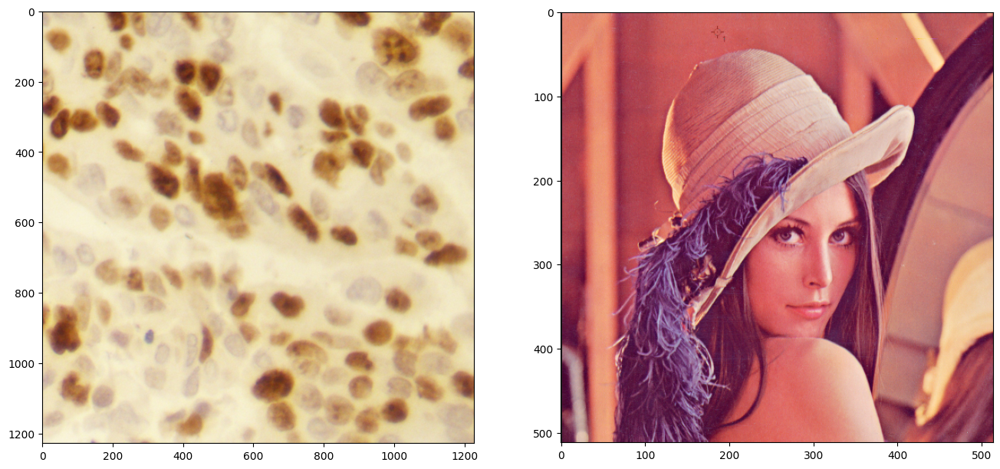

In [12]:
cells = cv2.imread('p17_0216_7.jpg')
lena = cv2.imread('Lena.jpg')
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells[..., ::-1]);
a2.imshow(lena[..., ::-1]);

In [5]:
def get_keypoints(image: np.ndarray, contrastThreshold: float, edgeThreshold: float):
    """image must be in GRAY scale"""
    sift: cv2.SIFT = cv2.SIFT_create(contrastThreshold=contrastThreshold, edgeThreshold=edgeThreshold)
    kps, _ = sift.detectAndCompute(image, mask=None)
    return kps

P1 = TypeVar('P1')
P2 = TypeVar('P2')
def plot_keypoints(
        image_base: np.ndarray,
        image_gray: np.ndarray,
        fun: Callable[[np.ndarray, P1, P2], Sequence[cv2.KeyPoint]],
        param1_space: Iterable[P1],
        param2_space: Iterable[P2],
        param1_name: str,
        param2_name: str,
        image_transform: Optional[Callable[[np.ndarray, P1, P2], np.ndarray]] = None
    ):
    _, axes = plt.subplots(
        len(param1_space), 
        len(param2_space), 
        figsize=(6 * len(param1_space), 6 * len(param2_space))
    )
    kpsizes = []
    for i, param1 in enumerate(param1_space):
        for j, param2 in enumerate(param2_space):
            ax = axes[i][j]
            keypoints = fun(image_gray, param1, param2)
            kpsizes.extend([(param1, param2, kp.size) for kp in keypoints])
            if image_transform is None:
                canvas = image_base.copy()
            else:
                canvas = image_transform(image_base.copy(), param1, param2)
            drawn = cv2.drawKeypoints(canvas, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
            ax.imshow(drawn)
            ax.axis('off')
            ax.set_title(f'{param1_name}: {param1}\n{param2_name}: {param2}')
    plt.show()

    kp_df = pd.DataFrame(kpsizes, columns=[param1_name, param2_name, "size"])
    _, axes = plt.subplots(1, 3, figsize=(25, 6))

    kps_count = kp_df.groupby([param1_name, param2_name]).count().reset_index()
    kp_df
    sns.heatmap(kps_count.pivot(index=param1_name, columns=param2_name, values="size"), annot=True, ax=axes[0])
    axes[0].set_title("liczba punktów kluczowych")

    kps_count = kp_df.groupby([param1_name, param2_name]).mean().reset_index()
    sns.heatmap(kps_count.pivot(index=param1_name, columns=param2_name, values="size"), annot=True, ax=axes[1])
    axes[1].set_title("średnia wielkości punktów kluczowych")

    kps_count = kp_df.groupby([param1_name, param2_name]).std().reset_index()
    sns.heatmap(kps_count.pivot(index=param1_name, columns=param2_name, values="size"), annot=True, ax=axes[2])
    axes[2].set_title("odchylenie wielkości punktów kluczowych")
    plt.show()

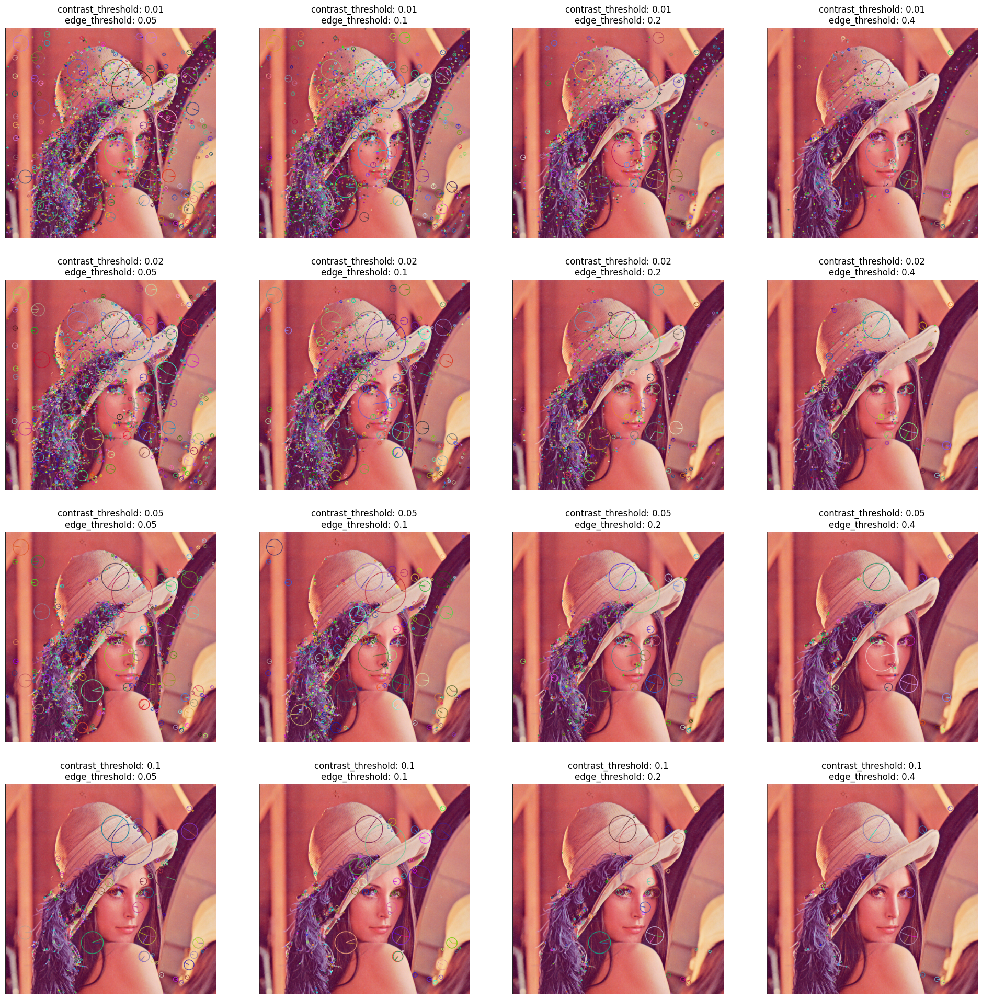

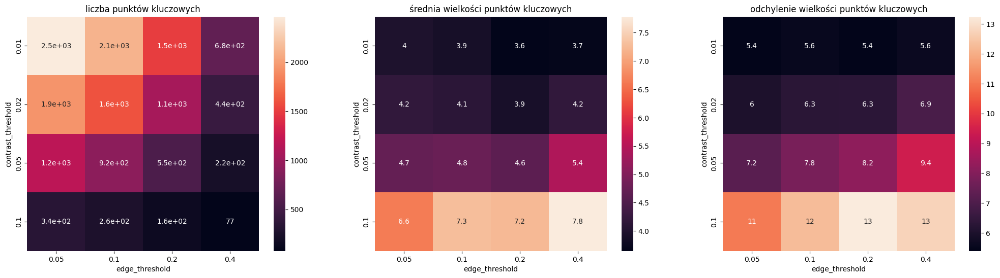

In [6]:
plot_keypoints(
    LENA, 
    LENA_GRAY, 
    get_keypoints, 
    [0.01, 0.02, 0.05, 0.1],
    [0.05, 0.1, 0.2, 0.4],
    'contrast_threshold',
    'edge_threshold'
    )

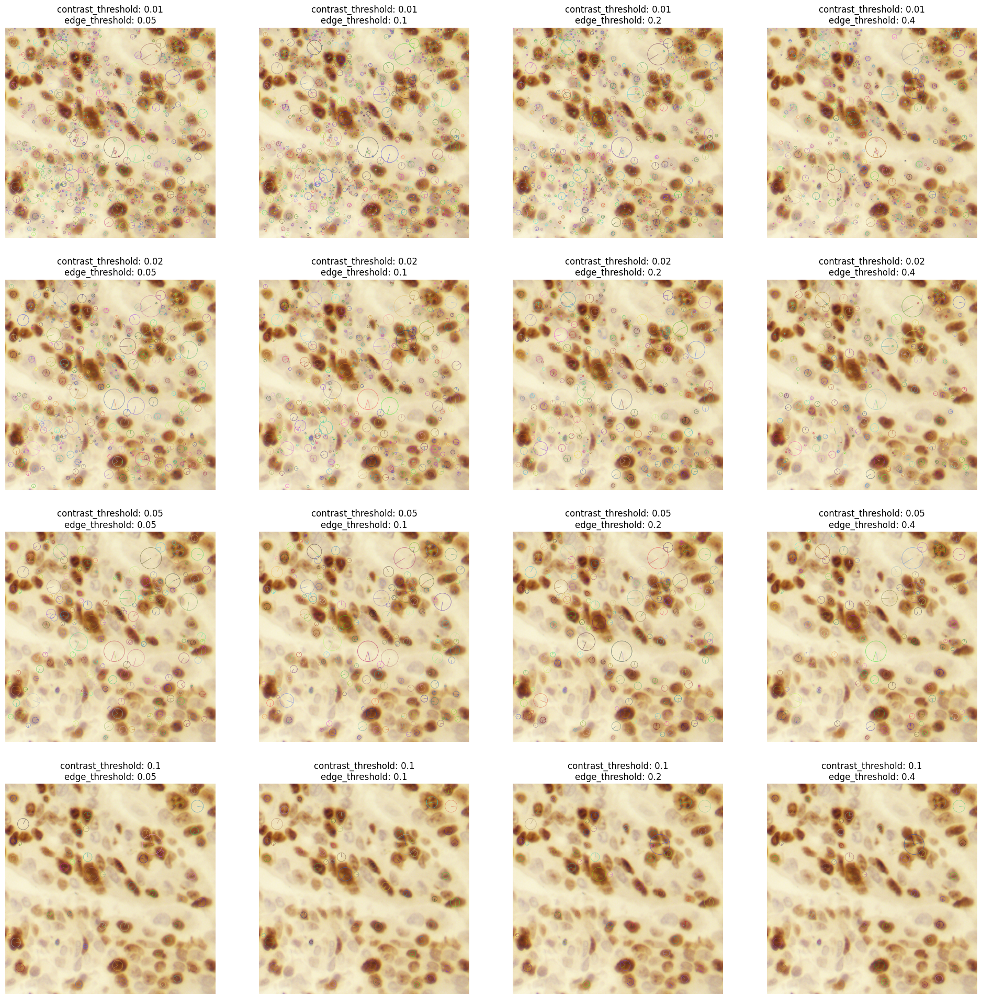

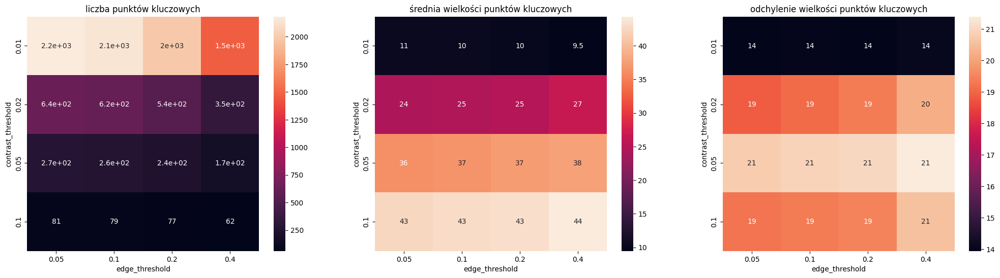

In [7]:
plot_keypoints(
    CELLS, 
    CELLS_GRAY, 
    get_keypoints, 
    [0.01, 0.02, 0.05, 0.1],
    [0.05, 0.1, 0.2, 0.4],
    'contrast_threshold',
    'edge_threshold'
    )

#### Zadanie 2

Detektor SIFT jest w teorii niezmienniczy względem translacji, rotacji czy zmiany skali. Przetestuj te własności w praktyce, oceniając wizualnie stabilność punktów wykrywanych na obróconej i przeskalowanej wersji obrazów `cells` i `lena`.

In [11]:
def rotate(image, angle, scale=1.0):
    center = (image.shape[0] // 2, image.shape[1] // 2)
    rmat = cv2.getRotationMatrix2D(center, angle, scale)
    return cv2.warpAffine(image, rmat, (image.shape[0], image.shape[1]), flags=cv2.INTER_CUBIC)

def get_keypoints_with_rotation(image: np.ndarray, angle: float, scale: float):
    """image must be in GRAY scale"""
    sift: cv2.SIFT = cv2.SIFT_create()
    kps, _ = sift.detectAndCompute(rotate(image, angle, scale), mask=None)
    return kps

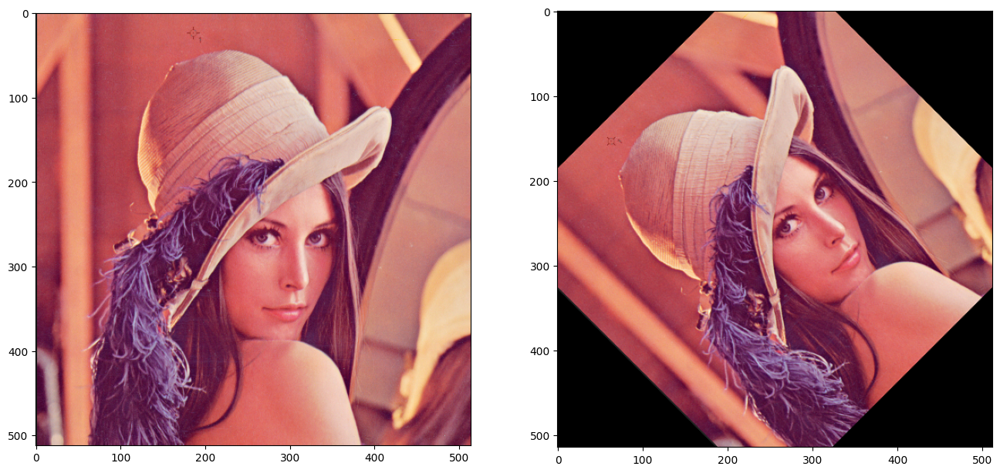

In [13]:
# przykład dla Leny, pamiętaj o cells!
lena_rot = rotate(lena, 45.0, scale=0.9)
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(lena[..., ::-1]);
a2.imshow(lena_rot[..., ::-1]);

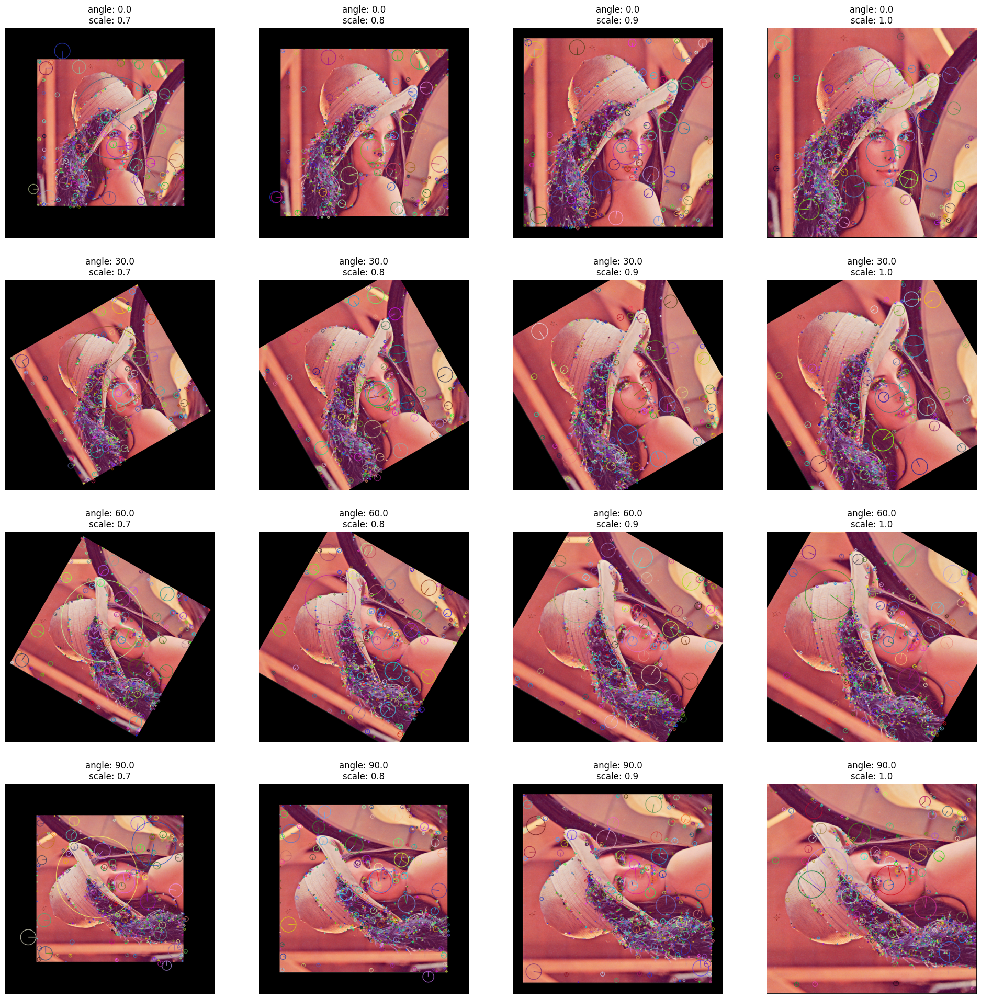

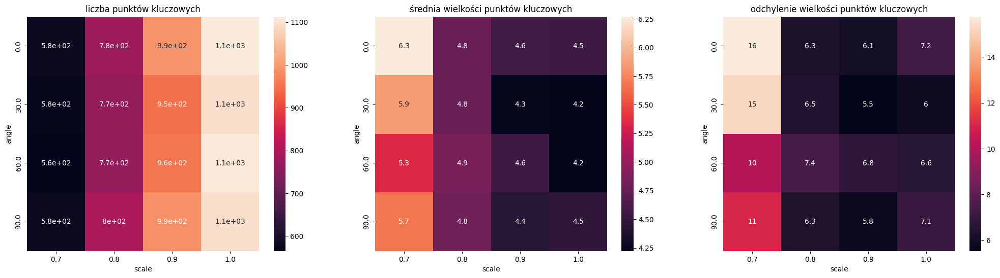

In [14]:
plot_keypoints(
    LENA,
    LENA_GRAY,
    get_keypoints_with_rotation,
    [0.0, 30.0, 60.0, 90.0],
    [0.7, 0.8, 0.9, 1.0],
    'angle',
    'scale',
    image_transform=rotate
)

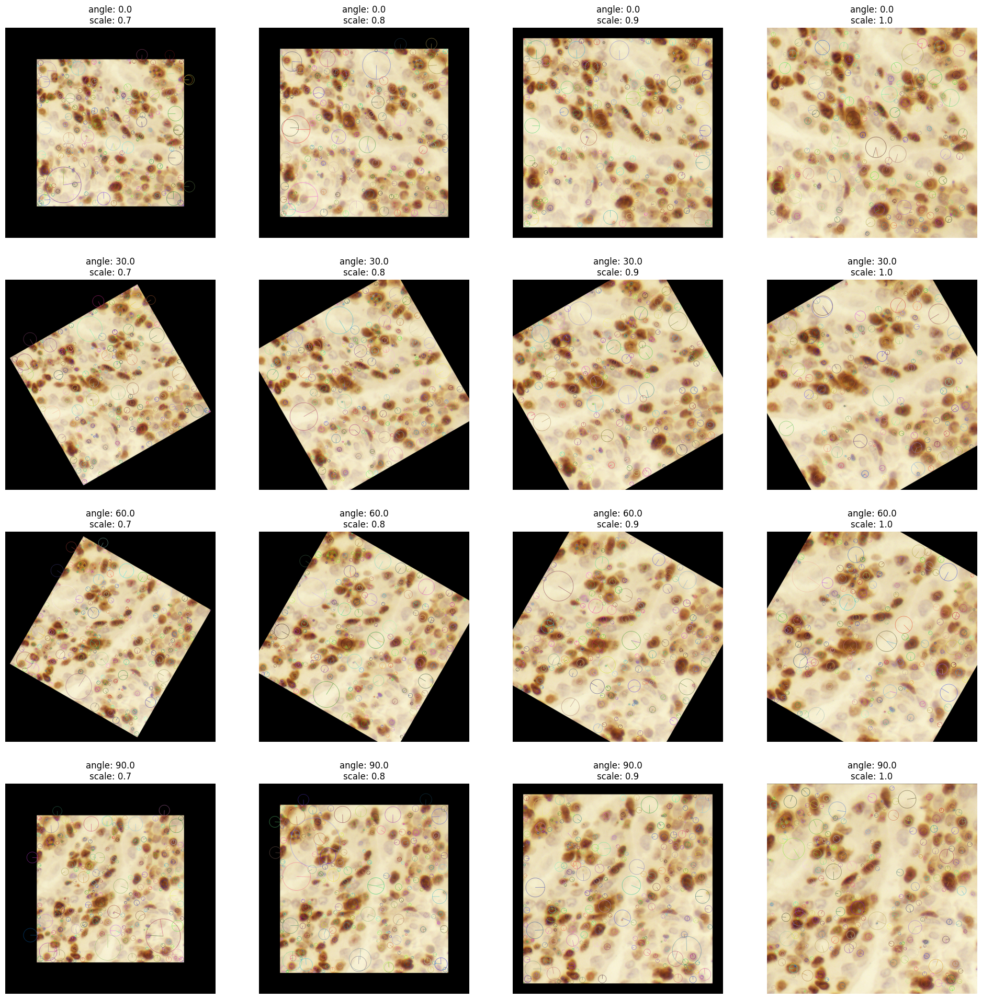

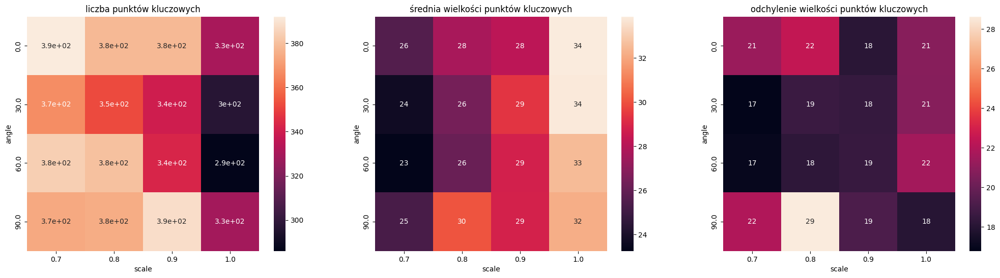

In [15]:
plot_keypoints(
    CELLS,
    CELLS_GRAY,
    get_keypoints_with_rotation,
    [0.0, 30.0, 60.0, 90.0],
    [0.7, 0.8, 0.9, 1.0],
    'angle',
    'scale',
    image_transform=rotate
)